## **00_Exploratory Data Analysis**


**Adriana de Vicente**

**Irma Sánchez**

After getting our data preprocessing ready, we nevertheless need to make experience of it. In EDA we examine numerous plots and in reality allow the statistics information for better analysis. This step will provide us a deeper expertise of statistical understanding.

Lets import required packages and load data

In [1]:

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import seaborn as sns
# Input data files are available in the "../input/" directory.
# For example, running this (by clicking run or pressing Shift+Enter) will list the files in the input directory
import matplotlib.pyplot as plt
import json
import collections
import re, string
import sys
import time
from nltk.corpus import stopwords
from wordcloud import WordCloud
#from mpl_toolkits.basemap import Basemap

from subprocess import check_output
import pandas as pd
import seaborn as sns
import networkx as nx
import numpy as np
import geopandas as gpd 
import matplotlib.pyplot as plt
from matplotlib.ticker import PercentFormatter
import heapq
import folium


In this step, we open the file containing the review data and read it into a list. We then use this list to create a Pandas DataFrame.

In [2]:
data_file = open('../data/raw/yelp_academic_dataset_review.json',encoding='utf8')
data=[]
for line in data_file:
    data.append(json.loads(line))
review_df = pd.DataFrame(data)
data_file.close()

In this step, we are reading in data from a json file into a Pandas DataFrame.

In [3]:
business_df = pd.read_json('../data/raw/yelp_academic_dataset_business.json',lines=True)

In [4]:
checkin_df = pd.read_json('../data/raw/yelp_academic_dataset_checkin.json',lines=True)

In [5]:
user_df = pd.read_json('../data/raw/yelp_academic_dataset_user.json',lines=True)

In this step, we are saving the business, review, and check-in dataframes to separate CSV files in the specified directory.

In [6]:
business_df.to_csv('../data/processed/business_df.csv', index=False)
review_df.to_csv('../data/processed/review_df.csv', index=False)
checkin_df.to_csv('../data/processed/checkin_df.csv', index=False)
user_df.to_csv('../data/processed/user_df.csv', index=False)

In this step, we are reading in the business data stored in a CSV file and storing it in a pandas DataFrame.

In [7]:
business_df = pd.read_csv('../data/processed/business_df.csv')

In [8]:
review_df = pd.read_csv('../data/processed/review_df.csv')

In this step, we are checking the shape of the business dataframe and printing the column names and the first few rows of the dataframe.

In [9]:
print(business_df.shape)
for col in business_df.columns:
    print(col)
business_df.head()

(150346, 14)
business_id
name
address
city
state
postal_code
latitude
longitude
stars
review_count
is_open
attributes
categories
hours


,business_id,name,address,city,state,postal_code,latitude,longitude,stars,review_count,is_open,attributes,categories,hours
0,Pns2l4eNsfO8kk83dixA6A,"Abby Rappoport, LAC, CMQ","1616 Chapala St, Ste 2",Santa Barbara,CA,93101,34.426679,-119.711197,5.0,7,0,{'ByAppointmentOnly': 'True'},"Doctors, Traditional Chinese Medicine, Naturop...",NaN
1,mpf3x-BjTdTEA3yCZrAYPw,The UPS Store,87 Grasso Plaza Shopping Center,Affton,MO,63123,38.551126,-90.335695,3.0,15,1,{'BusinessAcceptsCreditCards': 'True'},"Shipping Centers, Local Services, Notaries, Ma...","{'Monday': '0:0-0:0', 'Tuesday': '8:0-18:30', ..."
2,tUFrWirKiKi_TAnsVWINQQ,Target,5255 E Broadway Blvd,Tucson,AZ,85711,32.223236,-110.880452,3.5,22,0,"{'BikeParking': 'True', 'BusinessAcceptsCredit...","Department Stores, Shopping, Fashion, Home & G...","{'Monday': '8:0-22:0', 'Tuesday': '8:0-22:0', ..."
3,MTSW4McQd7CbVtyjqoe9mw,St Honore Pastries,935 Race St,Philadelphia,PA,19107,39.955505,-75.155564,4.0,80,1,"{'RestaurantsDelivery': 'False', 'OutdoorSeati...","Restaurants, Food, Bubble Tea, Coffee & Tea, B...","{'Monday': '7:0-20:0', 'Tuesday': '7:0-20:0', ..."
4,mWMc6_wTdE0EUBKIGXDVfA,Perkiomen Valley Brewery,101 Walnut St,Green Lane,PA,18054,40.338183,-75.471659,4.5,13,1,"{'BusinessAcceptsCreditCards': 'True', 'Wheelc...","Brewpubs, Breweries, Food","{'Wednesday': '14:0-22:0', 'Thursday': '16:0-2..."


The first line creates a new variable called "restaurant" and assigns to it a subset of the "business_df" DataFrame where the "categories" column is not empty (i.e., not "NaN" or "Not a Number"). The second line creates a new variable also called "restaurant" and assigns to it a subset of the previous "restaurant" DataFrame where the "categories" column contains the string "Restaurants".

In [10]:
restaurant = business_df[business_df["categories"].notna()]
restaurant = restaurant[restaurant["categories"].str.contains("Restaurants")]

o, the resulting map will show a series of CircleMarkers, each representing a restaurant location in the "restaurant_NA" DataFrame. The CircleMarkers will be displayed in red on the map.

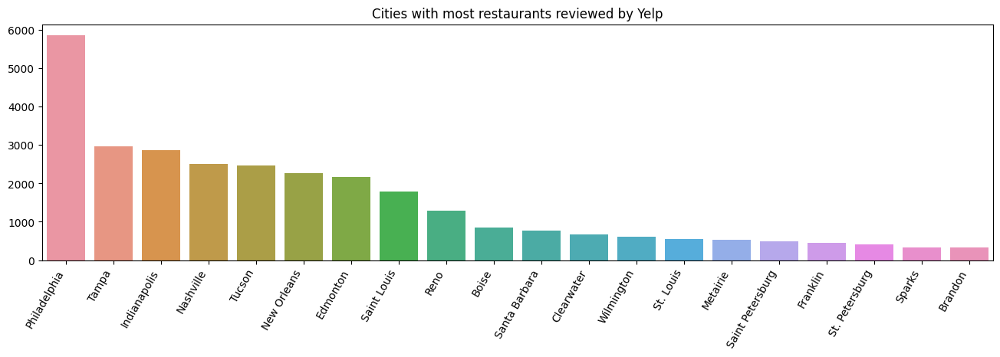

In [11]:
x = restaurant["city"].value_counts()
x = x.iloc[:20]
plt.figure(figsize=(16,4))
ax = sns.barplot(x=x.index, y=x.values)
ax.set_xticklabels(x.index, rotation=60, ha='right')
plt.title("Cities with most restaurants reviewed by Yelp")
plt.show()

In the following chart, it can be observed that the city with the most restaurants is Philadelphia, with a considerable difference compared to the other cities.

This code is creating a new DataFrame called "ratings" and assigning to it a subset of the "restaurant" DataFrame. The subset includes only the columns specified in the list within the square brackets (i.e., "name", "city", "latitude", "longitude", "stars", and "review_count").

In [12]:
ratings = restaurant[["name","city","latitude","longitude","stars","review_count"]]
ratings

,name,city,latitude,longitude,stars,review_count
3,St Honore Pastries,Philadelphia,39.955505,-75.155564,4.0,80
5,Sonic Drive-In,Ashland City,36.269593,-87.058943,2.0,6
8,Tsevi's Pub And Grill,Affton,38.565165,-90.321087,3.0,19
9,Sonic Drive-In,Nashville,36.208102,-86.768170,1.5,10
11,Vietnamese Food Truck,Tampa Bay,27.955269,-82.456320,4.0,10
...,...,...,...,...,...,...
150325,Wawa,Clifton Heights,39.925656,-75.310344,3.0,11
150327,Dutch Bros Coffee,Boise,43.615401,-116.284689,4.0,33
150336,Adelita Taqueria & Restaurant,Philadelphia,39.935982,-75.158665,4.5,35
150339,The Plum Pit,Aston,39.856185,-75.427725,4.5,14


The plot shows the locations of restaurants in Philadelphia.

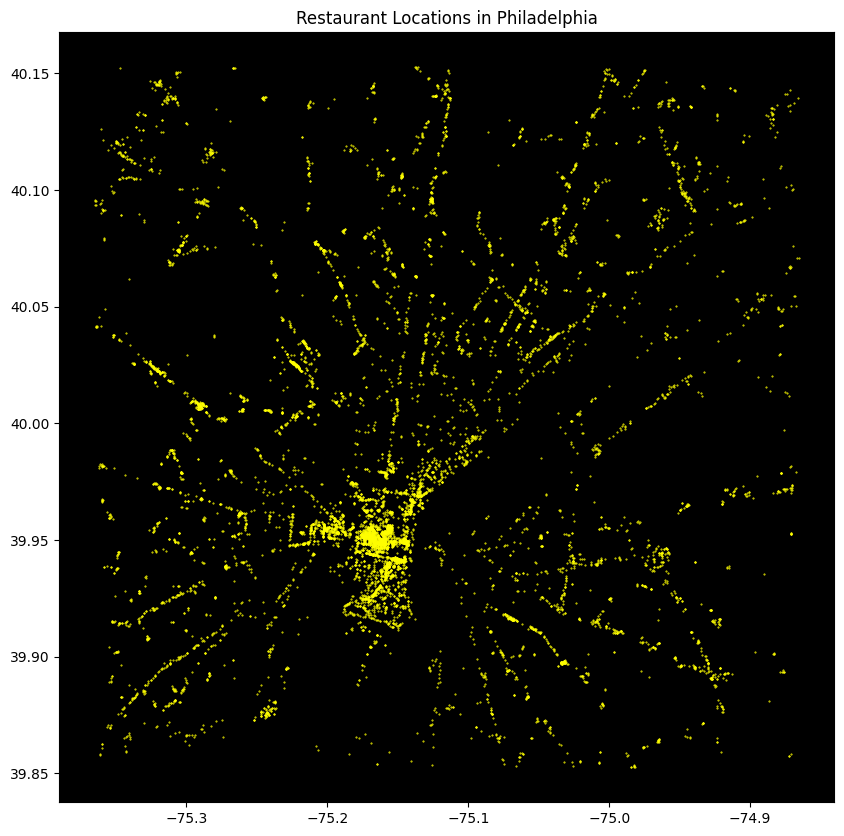

In [13]:
fig, ax = plt.subplots(figsize=(10, 10))

phi_lat, phi_lon = 39.9526, -75.1652
lon_min, lon_max = phi_lon - .2, phi_lon + .3
lat_min, lat_max = phi_lat - .1, phi_lat + .2

phi_mask = (restaurant['longitude']>lon_min) &\
            (restaurant['longitude']<lon_max) &\
            (restaurant['latitude']>lat_min) &\
            (restaurant['latitude']<lat_max)

phi_restaurant = restaurant[phi_mask]

ax.scatter(
        x=phi_restaurant['longitude'], 
        y=phi_restaurant['latitude'],
        c='yellow',
        s=0.2
        )
ax.set_title("Restaurant Locations in Philadelphia")
ax.set_facecolor('black')
plt.show()

In the following chart, we can see that restaurants in Philadelphia are more concentrated in the center of the city than in the suburbs.

This code is creating four new variables called "rest_lat", "rest_lon", "rest_name", and "rest_colour" based on the data in the "phi_restaurant" DataFrame.

In [14]:
rest_lat = phi_restaurant['latitude']
rest_lon = phi_restaurant['longitude']
rest_name = phi_restaurant['name']

phi_restaurant['marker_colour'] = pd.cut(phi_restaurant['stars'],bins=4,
                                        labels=['red','yellow','green','blue'])
rest_colour = phi_restaurant['marker_colour']

/var/folders/06/qj712s454zn0tljflkrgpwwm0000gn/T/ipykernel_2387/1779387711.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  phi_restaurant['marker_colour'] = pd.cut(phi_restaurant['stars'],bins=4,


In [15]:
m = folium.Map(location=[phi_lat, phi_lon])

feature_group = folium.FeatureGroup("Locations")
for lat, lng, name, color in zip(rest_lat, rest_lon, rest_name, rest_colour):
    feature_group.add_child(folium.CircleMarker(location=[lat,lng], popup=name,
                                               color=color, radius=3))

m.add_child(feature_group)

In the following plot, we can see an interactive map of the city of Philadelphia, divided into different areas based on latitude, longitude, and name.

The purpose of this code is to count the number of occurrences of each category in the "business_df" DataFrame, and to print the 10 categories with the highest count.

In [16]:
from collections import defaultdict

category = defaultdict(int)

for idx, row in business_df.iterrows():
    if row['categories'] is not np.nan: 
        entries = row['categories'].split(',')
        for entry in entries: 
            entry = entry.strip().lower()
            category[entry] += 1

print(len(category))
sorted_cate = sorted(category.items(), key=lambda x: x[1], reverse=True)
print(sorted_cate[:10])

1311
[('restaurants', 52268), ('food', 27781), ('shopping', 24395), ('home services', 14356), ('beauty & spas', 14292), ('nightlife', 12281), ('health & medical', 11890), ('local services', 11198), ('bars', 11065), ('automotive', 10773)]


From these results, we can understand that there are 1311 different categories in the "business_df" DataFrame, and that the "restaurants" category has the highest number of occurrences with 52268. The "food" category has the second highest number of occurrences with 27781, followed by the "shopping" category with 24395 occurrences. 

In [17]:
business_df.head()

,business_id,name,address,city,state,postal_code,latitude,longitude,stars,review_count,is_open,attributes,categories,hours
0,Pns2l4eNsfO8kk83dixA6A,"Abby Rappoport, LAC, CMQ","1616 Chapala St, Ste 2",Santa Barbara,CA,93101,34.426679,-119.711197,5.0,7,0,{'ByAppointmentOnly': 'True'},"Doctors, Traditional Chinese Medicine, Naturop...",NaN
1,mpf3x-BjTdTEA3yCZrAYPw,The UPS Store,87 Grasso Plaza Shopping Center,Affton,MO,63123,38.551126,-90.335695,3.0,15,1,{'BusinessAcceptsCreditCards': 'True'},"Shipping Centers, Local Services, Notaries, Ma...","{'Monday': '0:0-0:0', 'Tuesday': '8:0-18:30', ..."
2,tUFrWirKiKi_TAnsVWINQQ,Target,5255 E Broadway Blvd,Tucson,AZ,85711,32.223236,-110.880452,3.5,22,0,"{'BikeParking': 'True', 'BusinessAcceptsCredit...","Department Stores, Shopping, Fashion, Home & G...","{'Monday': '8:0-22:0', 'Tuesday': '8:0-22:0', ..."
3,MTSW4McQd7CbVtyjqoe9mw,St Honore Pastries,935 Race St,Philadelphia,PA,19107,39.955505,-75.155564,4.0,80,1,"{'RestaurantsDelivery': 'False', 'OutdoorSeati...","Restaurants, Food, Bubble Tea, Coffee & Tea, B...","{'Monday': '7:0-20:0', 'Tuesday': '7:0-20:0', ..."
4,mWMc6_wTdE0EUBKIGXDVfA,Perkiomen Valley Brewery,101 Walnut St,Green Lane,PA,18054,40.338183,-75.471659,4.5,13,1,"{'BusinessAcceptsCreditCards': 'True', 'Wheelc...","Brewpubs, Breweries, Food","{'Wednesday': '14:0-22:0', 'Thursday': '16:0-2..."


In the following table, we can see the values in the "business" table.

In [18]:
business = business_df.set_index('business_id')

business.shape


(150346, 13)

This result shows that there are 150346 rows and 13 columns in the "business" table.

In [19]:
business['categories'].value_counts()


Beauty & Spas, Nail Salons                                                                                       1012
Restaurants, Pizza                                                                                                935
Nail Salons, Beauty & Spas                                                                                        934
Pizza, Restaurants                                                                                                823
Restaurants, Mexican                                                                                              728
                                                                                                                 ... 
Dermatologists, Health & Medical, Cosmetic Surgeons, Doctors, Acne Treatment, Skin Care, Beauty & Spas              1
Home Services, Home & Garden, Nurseries & Gardening, Hardware Stores, Shopping, Building Supplies, Appliances       1
Food Trucks, Smokehouse, Restaurants, Food, Barbeque, So

This table shows the number of occurrences of each combination of categories in the "categories" column of the "business" DataFrame. For example, the combination of categories "Beauty & Spas, Nail Salons" has 1012 occurrences, while the combination "Restaurants, Pizza" has 935 occurrences. The combination of categories "Pizza, Restaurants" also has 823 occurrences, and the combination "Restaurants, Mexican" has 728 occurrences.

It's important to note that these category combinations do not necessarily have to be exclusive. For example, a business can be both a pizza restaurant and a Mexican restaurant. In this case, the combination of categories "Restaurants, Pizza, Mexican" would be counted in each of these rows.

In [20]:
business['categories'].isna().sum()


103

This result shows that there are 103 missing values in the "categories" column of the "business" DataFrame.

In [21]:
business['categories'].str.split(', ', expand=True).stack().value_counts().head(20)


Restaurants                  52268
Food                         27781
Shopping                     24395
Home Services                14356
Beauty & Spas                14292
Nightlife                    12281
Health & Medical             11890
Local Services               11198
Bars                         11065
Automotive                   10773
Event Planning & Services     9895
Sandwiches                    8366
American (Traditional)        8139
Active Life                   7687
Pizza                         7093
Coffee & Tea                  6703
Fast Food                     6472
Breakfast & Brunch            6239
American (New)                6097
Hotels & Travel               5857
dtype: int64

In this case, we can see that the most common category is "Restaurants" with 52268 occurrences, followed by the category "Food" with 27781 occurrences. The category "Shopping" has 24395 occurrences, followed by the category "Home Services" with 14356 occurrences. The categories "Beauty & Spas", "Nightlife", and "Health & Medical" have a similar number of occurrences, followed by the category "Local Services" with 11198 occurrences. The categories "Bars", "Automotive", and "Event Planning & Services" also have a similar number of occurrences.

In [22]:

categories = business['categories'].str.split(', ', expand=True)


In [23]:
df = categories.T.stack().groupby('business_id').apply(list).reset_index(name='categories')
df

,business_id,categories
0,---kPU91CF4Lq2-WlRu9Lw,"[Seafood, Restaurants, Latin American, Food, F..."
1,--0iUa4sNDFiZFrAdIWhZQ,"[Food, Restaurants, Specialty Food, Mexican, E..."
2,--30_8IhuyMHbSOcNWd6DQ,"[Trainers, Active Life, Fitness & Instruction,..."
3,--7PUidqRWpRSpXebiyxTg,"[Breakfast & Brunch, Restaurants]"
4,--7jw19RH9JKXgFohspgQw,"[Orthodontists, Health & Medical, General Dent..."
...,...,...
150238,zznZqH9CiAznbkV6fXyHWA,"[Pop-Up Restaurants, Cuban, Restaurants, Hondu..."
150239,zztOG2cKm87I6Iw_tleZsQ,"[Test Preparation, Specialty Schools, Adult Ed..."
150240,zzu6_r3DxBJuXcjnOYVdTw,"[Restaurants, Cafes, Italian]"
150241,zzw66H6hVjXQEt0Js3Mo4A,"[Nurseries & Gardening, Home Services, Shoppin..."


In [24]:
from sklearn.preprocessing import MultiLabelBinarizer

mlb = MultiLabelBinarizer()
df = df.join(pd.DataFrame(mlb.fit_transform(df.pop('categories')),
                          columns=mlb.classes_,
                          index=df.index))


In [25]:
df

,business_id,& Probates,3D Printing,ATV Rentals/Tours,Acai Bowls,Accessories,Accountants,Acne Treatment,Active Life,Acupuncture,...,Wine Tasting Room,Wine Tours,Wineries,Women's Clothing,Workers Compensation Law,Wraps,Yelp Events,Yoga,Ziplining,Zoos
0,---kPU91CF4Lq2-WlRu9Lw,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,--0iUa4sNDFiZFrAdIWhZQ,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,--30_8IhuyMHbSOcNWd6DQ,0,0,0,0,0,0,0,1,0,...,0,0,0,0,0,0,0,0,0,0
3,--7PUidqRWpRSpXebiyxTg,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,--7jw19RH9JKXgFohspgQw,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
150238,zznZqH9CiAznbkV6fXyHWA,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
150239,zztOG2cKm87I6Iw_tleZsQ,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
150240,zzu6_r3DxBJuXcjnOYVdTw,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
150241,zzw66H6hVjXQEt0Js3Mo4A,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


this code transforms the "categories" column into an array of binary labels and joins it to the original DataFrame.

<AxesSubplot: >

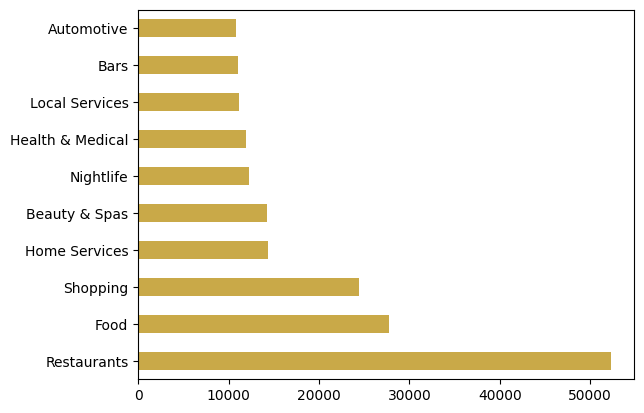

In [26]:
business['categories'].str.split(', ', expand=True).stack().value_counts().head(10).plot.barh(color='#C9A948')


The category with the greatest value is that of restaurants

In [27]:
attributes = pd.json_normalize(business_df['attributes'])

In [28]:
attributes.set_index(business.index, inplace=True)
attributes['business_id'] = attributes.index
attributes.reset_index(drop=True, inplace=True)

In [29]:
attributes

,business_id
0,Pns2l4eNsfO8kk83dixA6A
1,mpf3x-BjTdTEA3yCZrAYPw
2,tUFrWirKiKi_TAnsVWINQQ
3,MTSW4McQd7CbVtyjqoe9mw
4,mWMc6_wTdE0EUBKIGXDVfA
...,...
150341,IUQopTMmYQG-qRtBk-8QnA
150342,c8GjPIOTGVmIemT7j5_SyQ
150343,_QAMST-NrQobXduilWEqSw
150344,mtGm22y5c2UHNXDFAjaPNw


## **BUSINESS TABLE INSIGHT WITH PLOTS:**

In [30]:
attributes.isnull().sum()


business_id    0
dtype: int64

 it is showing that there are 0 null values in the "business_id" column.

In the dataset **business_df**, we have preprocessed the attribute columns and added the important features in individual columns




Terminology used:
1. __Top reviewed business__ : Business with most numbers of positive reviews
1. __Negatively reviewed business__ : Business with most numbers of negative reviews
1. __Trending business__ : Business with most number of reviews, with more than 4 stars in recent years
1. __Positive review__ : Review with more than 3 stars
1. __Negative review__ : Review with just 1 star

# Top reviewed business

**Top 5 star-rated Restuarants sorted by review count**

[Text(0.5, 0, 'Restaurant'), Text(0, 0.5, 'Review Count')]

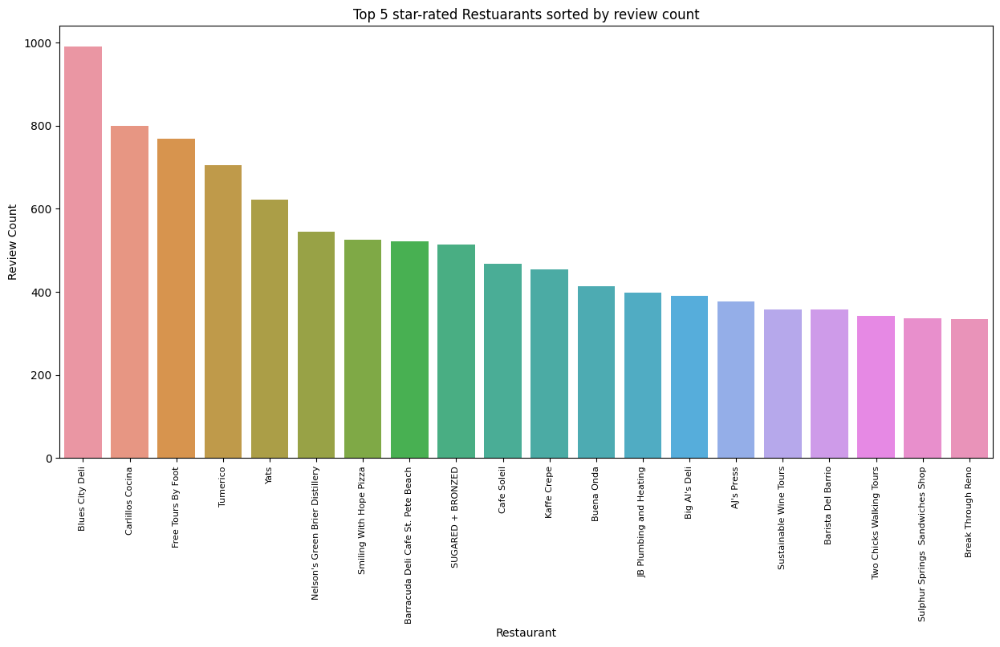

In [31]:
toprating_df = business_df[business_df["stars"]==5]
toprating_df = toprating_df.sort_values('review_count', ascending=False).head(20)

plt.figure(figsize=(15,7))
p = sns.barplot(x='name', y="review_count", data=toprating_df,)
p.set_xticklabels(p.get_xticklabels(), rotation = 90, fontsize = 8)
p.set_title("Top 5 star-rated Restuarants sorted by review count")
p.set(xlabel="Restaurant", ylabel="Review Count")

This graph shows the top 5-stared restuarants with the review count.for Powells city of books the review count is drastically high above 4000. 

Restuarants sorted by  minimum review count

"Top 5 star-rated Restaurants sorted by mean of ratings

[Text(0.5, 0, 'Restaurant'), Text(0, 0.5, 'Rating')]

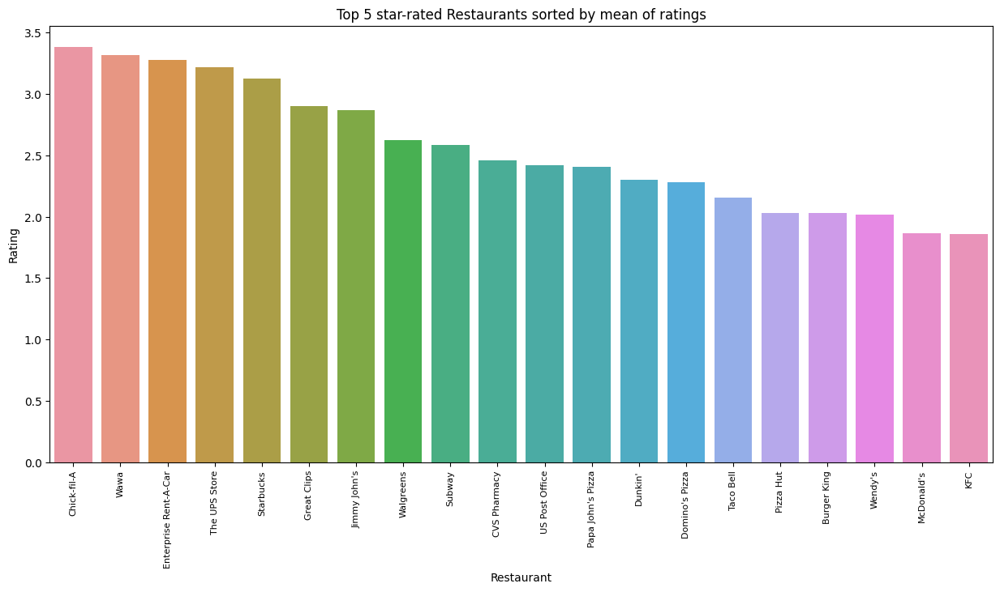

In [32]:
df_restaurants = business_df.name.value_counts().index[:20].tolist()
df_top = business_df.loc[business_df['name'].isin(df_restaurants)]
mean_df = df_top.groupby('name')['stars'].mean()
meanrating_df = mean_df.reset_index()
topmean_rating_df = meanrating_df.sort_values('stars', ascending=False).head(20)

plt.figure(figsize=(15,7))
p = sns.barplot(x='name', y="stars",data=topmean_rating_df)
ax = plt.gca()
p.set_xticklabels(p.get_xticklabels(), rotation = 90, fontsize = 8)
p.set_title("Top 5 star-rated Restaurants sorted by mean of ratings")
p.set(xlabel="Restaurant", ylabel="Rating")


The plot show the top 5 star rated resturants that sorted by mean of ratings and rubix get the top rating .

##Which location the business were located in the world map?

Text(0.5, 1.0, 'BUSINESS DISTRIBUTION ON WORLD MAP')

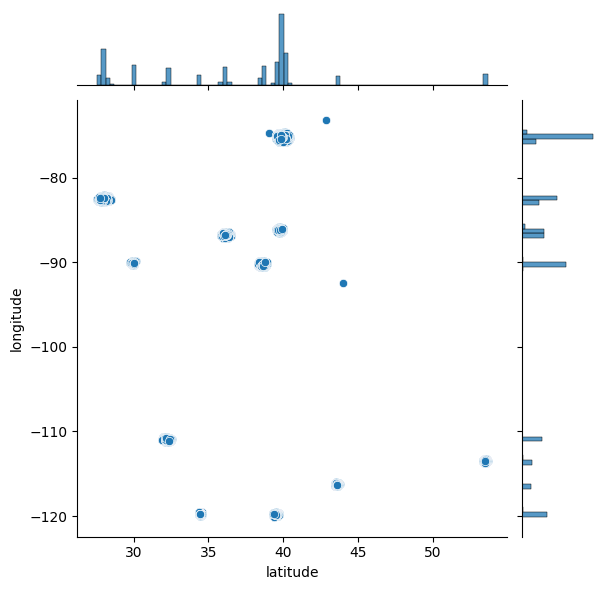

In [33]:
sns.jointplot(data=business_df, x='latitude', y='longitude')
ax.set_title("BUSINESS DISTRIBUTION ON WORLD MAP")

We see that locations of businesses are concentrated in clusters. These clusters must be big cities. Lets plot these on a map.

[Text(0.5, 23.999999999999986, 'longitude'),
 Text(24.000000000000007, 0.5, 'latitude')]

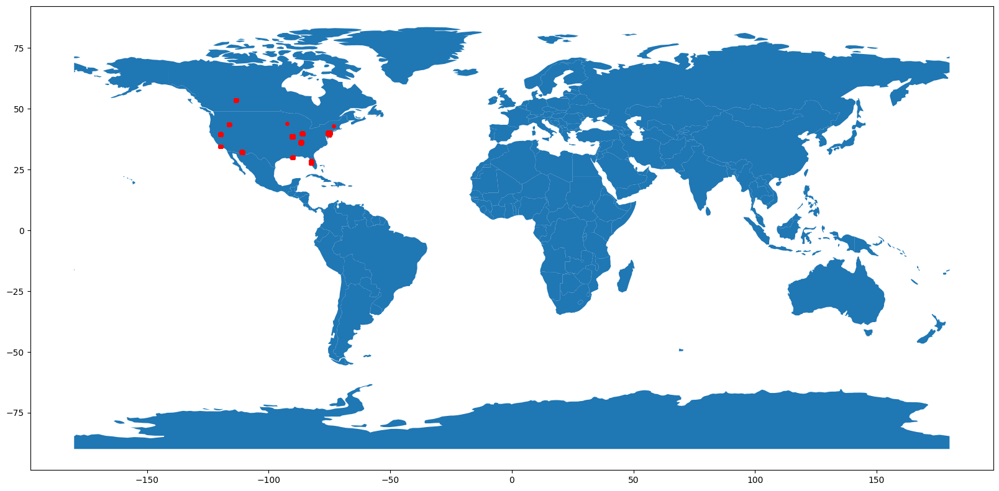

In [34]:
import pandas as pd
from shapely.geometry import Point
import geopandas as gpd
from geopandas import GeoDataFrame



geometry = [Point(xy) for xy in zip(business_df['longitude'], business_df['latitude'])]
gdf = GeoDataFrame(business_df, geometry=geometry)   

#this is a simple map that goes with geopandas
world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))

ax.set_title("BUSINESS DISTRIBUTION ON WORLD MAP")
gdf.plot(ax=world.plot(figsize=(20, 12)),marker='o', color='red', markersize=15)
ax.set(xlabel="longitude", ylabel = "latitude")

This is a 2d plot for the location of business distribution across the world.this plot shows that the dataset has the bussiness from north america,there is a also outlier spoted in the graph.

In [35]:
import plotly.express as px
import pandas as pd
fig = px.scatter_geo(business_df,lat='latitude',lon='longitude', hover_name="city")
fig.update_layout(title = 'BUSINESS DISTRIBUTION ON WORLD MAP', title_x=0.5)
fig.show()

This plot show 3d visulization of the business distrubution across the world.the outlier we found to be in jumaica plain.

**Total count of restruant is_open:**

Text(0.5, 1.0, 'Total count of restruant is_open:')

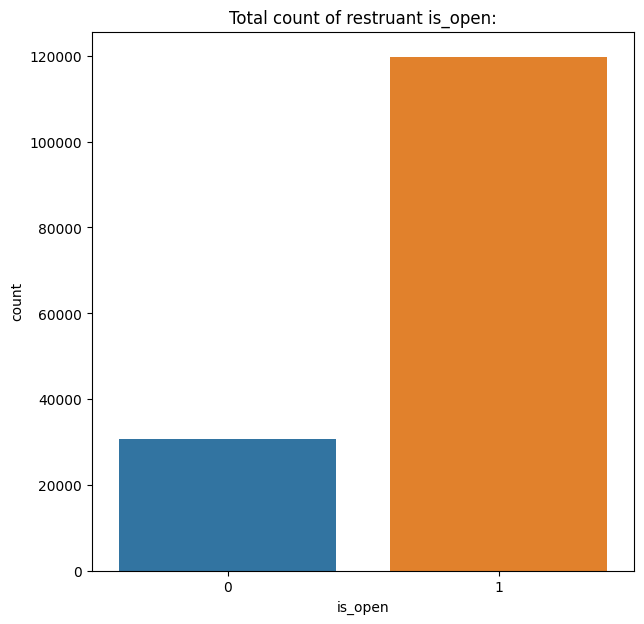

In [36]:
plt.figure(figsize=(7,7))
ax = sns.countplot(x="is_open", data=business_df)
plt.title("Total count of restruant is_open:")

Mostly the review count say that resturants are open . according to the dataset 40,000 resturants are closed .

#Trend of Atributes in the resturant based on star ratings

Trend of happy hours in the resturant based on star ratings

Trend of ambience_romantic in the resturant based on star ratings shows that the place where couples prefer to stay like candle light dinner and how far the resturant

Most Popular Zip codes

Text(0, 0.5, 'Count')

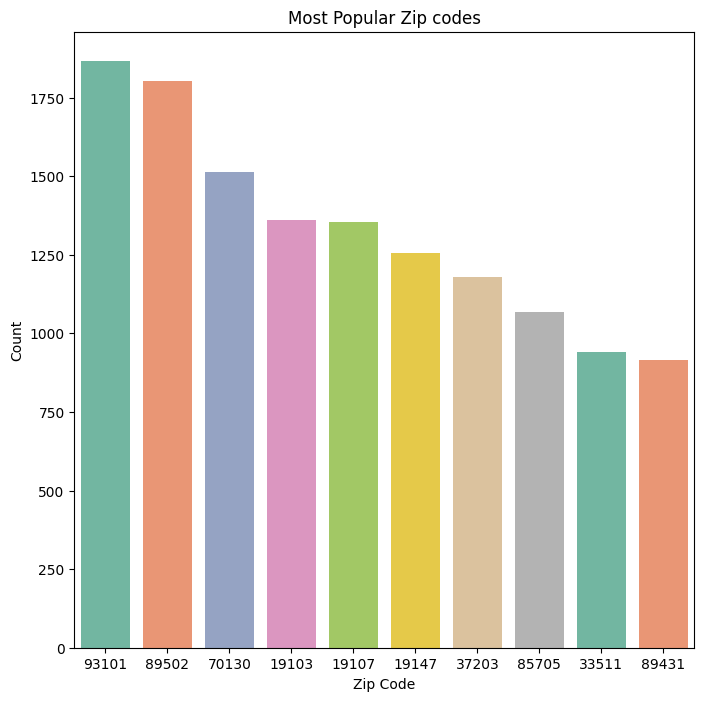

In [37]:
plt.figure(figsize=(8,8))
top_10_zip = business_df["postal_code"].value_counts()[:10]
sns.barplot(x=top_10_zip.index, y=top_10_zip.values,palette=sns.color_palette("Set2"))
ax = plt.gca()
ax.set_title('Most Popular Zip codes')
ax.set_xlabel('Zip Code')
ax.set_ylabel('Count')


the most popular zip code is 93101

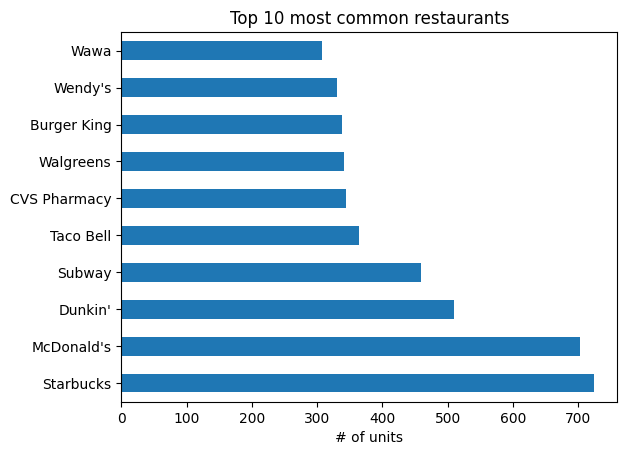

In [38]:
# ten most common restaurant names
business_df.name.value_counts()[:10].plot(kind='barh');
plt.xlabel('# of units');
plt.title('Top 10 most common restaurants');

The most common restaurant is starbucks

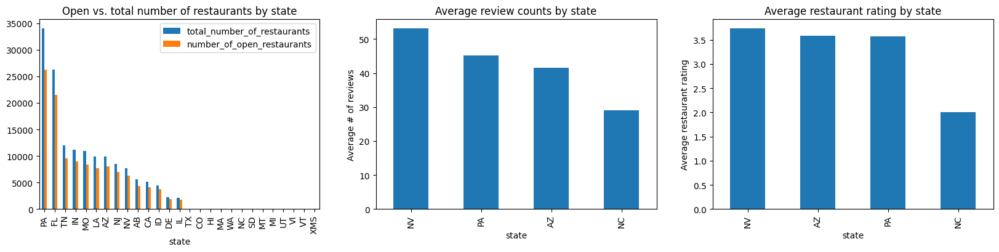

In [39]:
plt.figure(figsize=(20,4))

# total number of restaurants vs open restaurants by state
ax1 = plt.subplot(1,3,1)
open_by_state = business_df.groupby('state')['is_open'].agg(['count','sum']).sort_values(by=['count'],ascending=False)
open_by_state.columns = ['total_number_of_restaurants','number_of_open_restaurants']
open_by_state.plot(kind='bar',ax=ax1);
ax1.set_title('Open vs. total number of restaurants by state');

# create a groupby object based on the top five states
groupby_5state = business_df[business_df.state.isin(['AZ','NV','OH','NC','PA'])].groupby('state')

# average review_count by state for top five states
ax2 = plt.subplot(1,3,2)
groupby_5state['review_count'].mean().sort_values(ascending=False).plot(kind='bar', ax=ax2);
ax2.set_ylabel('Average # of reviews');
ax2.set_title('Average review counts by state');

# average rating by state for top five states
ax3 = plt.subplot(1,3,3)
groupby_5state['stars'].mean().sort_values(ascending=False).plot(kind='bar', ax=ax3);
ax3.set_ylabel('Average restaurant rating');
ax3.set_title('Average restaurant rating by state');

This code generates three bar graphs. The first shows the total number of restaurants and the number of restaurants open in each state, where the largest is 'PA'. The second graph shows the average number of reviews in the five states with the most restaurants, with the highest being 'NV'. The third chart shows the average rating of restaurants in the five states with the most restaurants, with the highest being 'NV'.

/var/folders/06/qj712s454zn0tljflkrgpwwm0000gn/T/ipykernel_2387/3892874817.py:20: UserWarning:

FixedFormatter should only be used together with FixedLocator



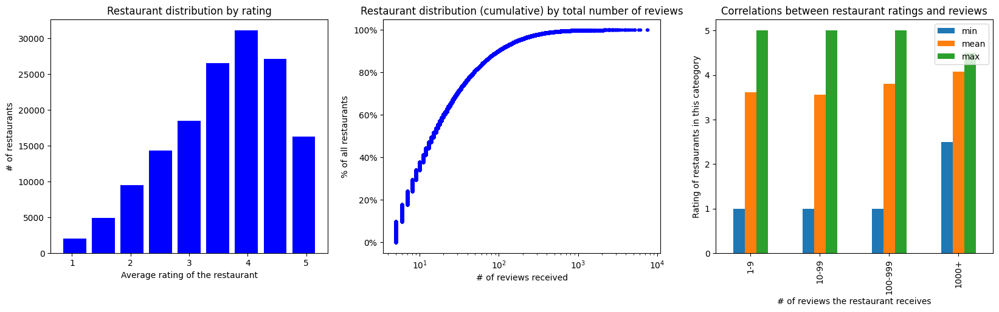

In [40]:
plt.figure(figsize=(20,5))

# restaurant distribution by rating
ax1 = plt.subplot(1,3,1)
business_df.stars.plot(kind='hist', bins=9, range=(0.8, 5.2), rwidth=0.8, color = 'blue', ax=ax1);
ax1.set_xlabel('Average rating of the restaurant');
ax1.set_ylabel('# of restaurants');
ax1.set_title('Restaurant distribution by rating');

# restaurant distribution by review counts
def ecdf(array):
    """Compute ECDF for 1D array of measurement data."""
    x = np.sort(array)  #sort array to use as the x axis    
    y = np.arange(1, len(array)+1)/len(array) #use np.arange to create the y axis for cdf from 1/len to 1
    return x,y

ax2 = plt.subplot(1,3,2)
x,y = ecdf(business_df.review_count)
ax2.plot(x, y, marker = '.', linestyle='none',color='blue');
ax2.set_yticklabels(['{:.0%}'.format(x) for x in ax2.get_yticks()])
ax2.set_xscale('log');
ax2.set_xlabel('# of reviews received');
ax2.set_ylabel('% of all restaurants');
ax2.set_title('Restaurant distribution (cumulative) by total number of reviews');

# correlation between rating and review
ax3 = plt.subplot(1,3,3)
count_cat = np.log10(business_df.review_count)//1
busi_by_rev_count = business_df.groupby(count_cat)['stars'].agg(['min','mean','max'])
busi_by_rev_count.index = ['1-9','10-99','100-999','1000+']
busi_by_rev_count.plot(kind='bar', ax=ax3);
ax3.set_xlabel('# of reviews the restaurant receives');
ax3.set_ylabel('Rating of restaurants in this cateogory');
ax3.set_title('Correlations between restaurant ratings and reviews');

##Top reviewed business

In [41]:
top_reviewed = review_df[review_df["stars"]>3]
top_reviews_dict ={}

for business_id in top_reviewed["business_id"].values:
    try :
        top_reviews_dict[business_id] =top_reviews_dict[business_id]+1
    except:
        top_reviews_dict[business_id]=1
        
topbusiness = pd.DataFrame.from_dict(data= top_reviews_dict,orient="index")

topbusiness.reset_index(inplace=True)
topbusiness.columns = ['business_id', 'rated']
del(top_reviews_dict)
del(top_reviewed)

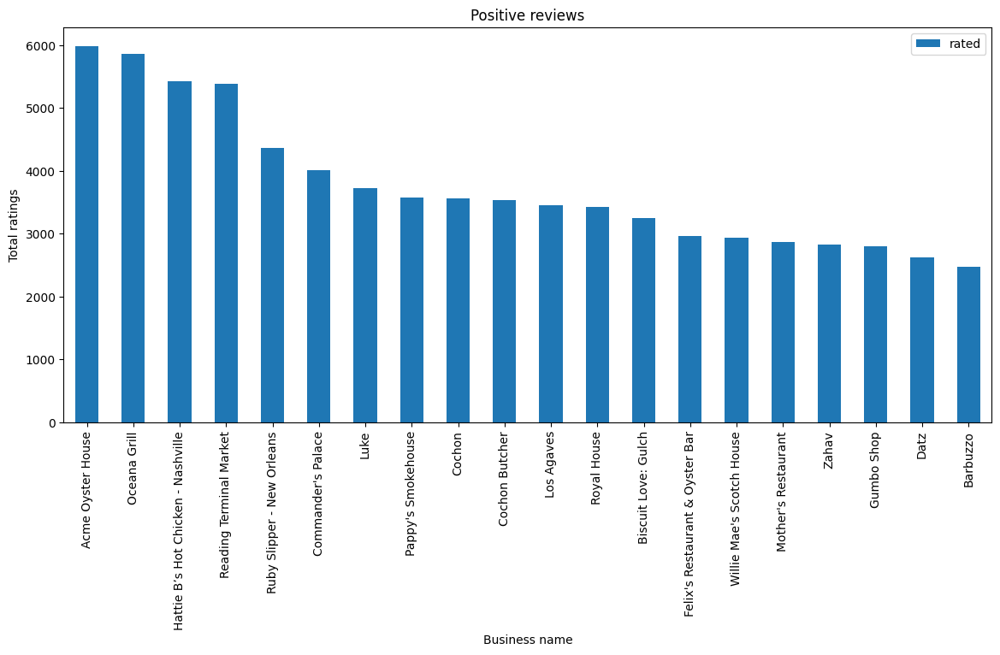

In [42]:
top_count= 20
right=pd.DataFrame(business_df[['business_id',"name","categories"]].values,
                    columns=['business_id',"Business name","categories"])

top_business_data = pd.merge(topbusiness,right=right, how="inner",on='business_id')
top_business_data.sort_values("rated")[::-1][:top_count].plot(x="Business name",y="rated", 
                                                   kind="bar",figsize=(14,6),
                                                   title='Positive reviews').set_ylabel("Total ratings")

del(topbusiness)
del(right)

In this we consider the star rating above 3 to be positive ratings and have positive reviews with insight that restruants are mostly liked by people.these are top business name

# How businesses are getting reviewed over time


Some businesses try to maintain their overall quality standards and make their customers happy. Lets see which businesses are maintaining their quality standards  based on positive reviews.

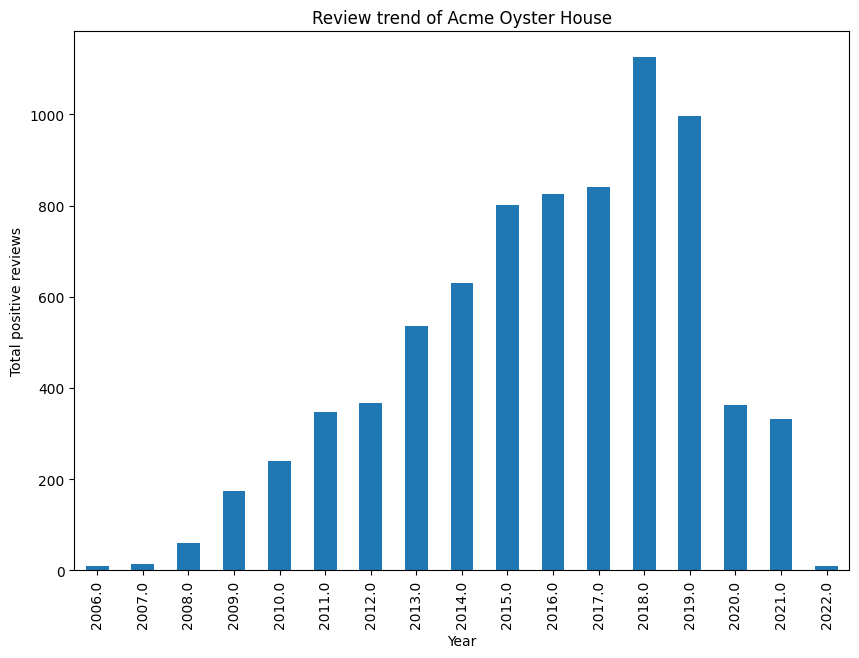

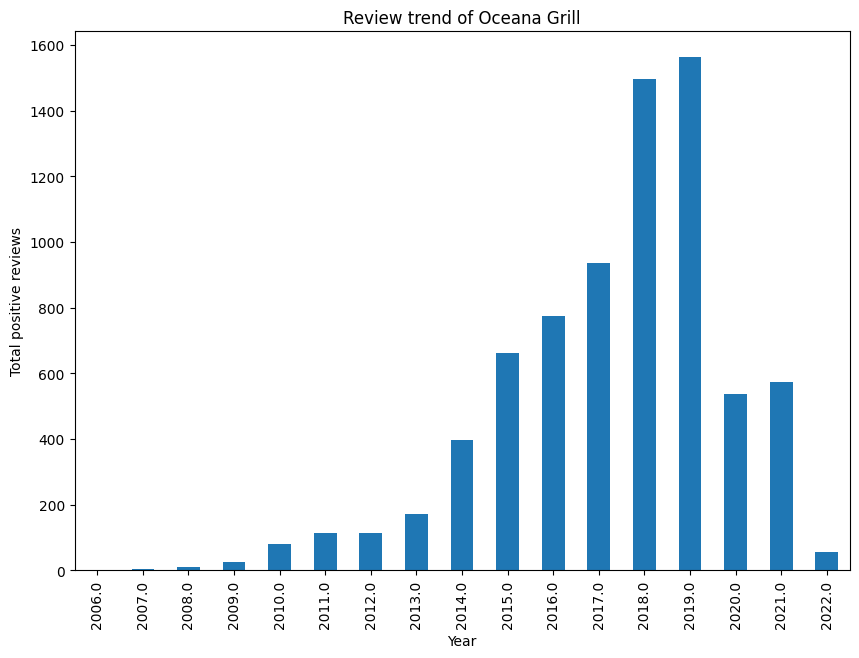

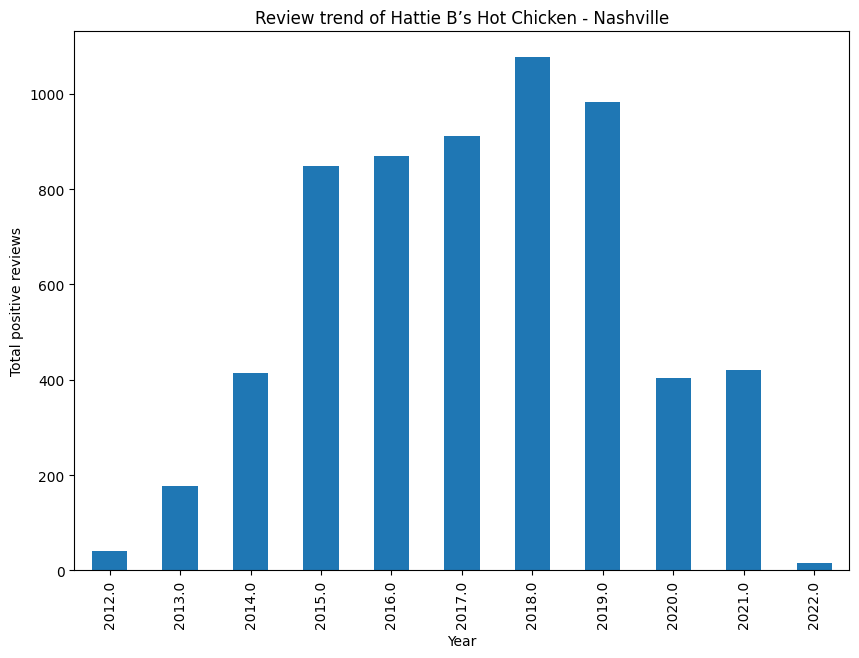

In [43]:
review_df['year'] = pd.to_datetime(review_df['date']).dt.year

num_business = 3
business_ids = top_business_data.sort_values("rated")[::-1][:num_business].business_id.values
business_names = top_business_data.sort_values("rated")[::-1][:num_business]["Business name"].values
for i, business_id in enumerate(business_ids):
    useful_b = review_df.loc[review_df['business_id'] == business_id]
    useful_b = useful_b.groupby(['year']).size().reset_index(name='counts')
    #print(useful_b.head())
    series = pd.Series(useful_b["counts"].values, index=useful_b["year"].values, name='Review trend')
    axes = series.plot(kind="bar",figsize=(10, 7))
    plt.xlabel('Year', axes=axes)
    plt.ylabel('Total positive reviews', axes=axes)
    plt.title('Review trend of {}'.format(business_names[i]), axes=axes)
    plt.show()


Based on above graphs one can see that positive reviews of "screen door" is dropping this can mean either people are not visiting "screen door" or quality standards of this business is definitely dropping over time.



# Most recent Trending businesses

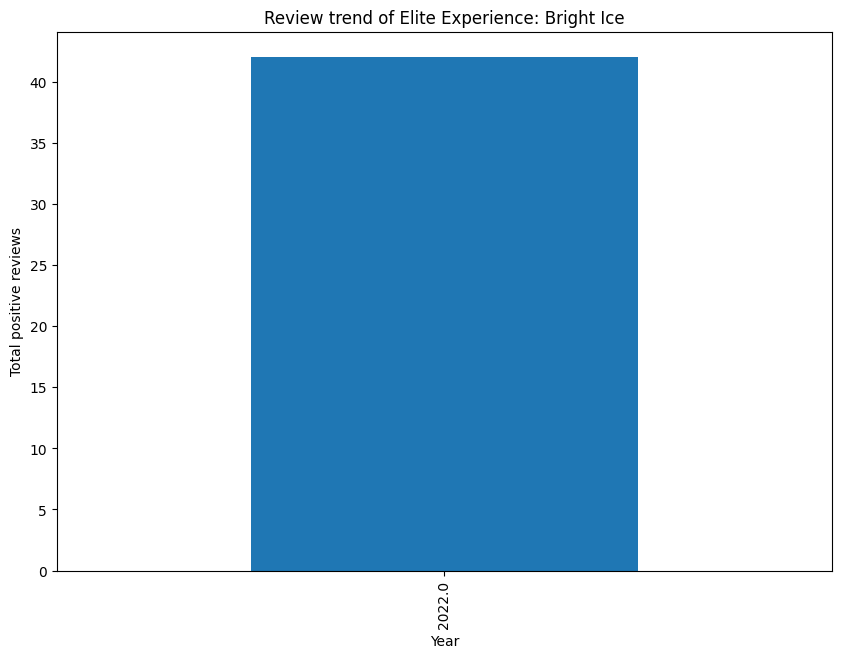

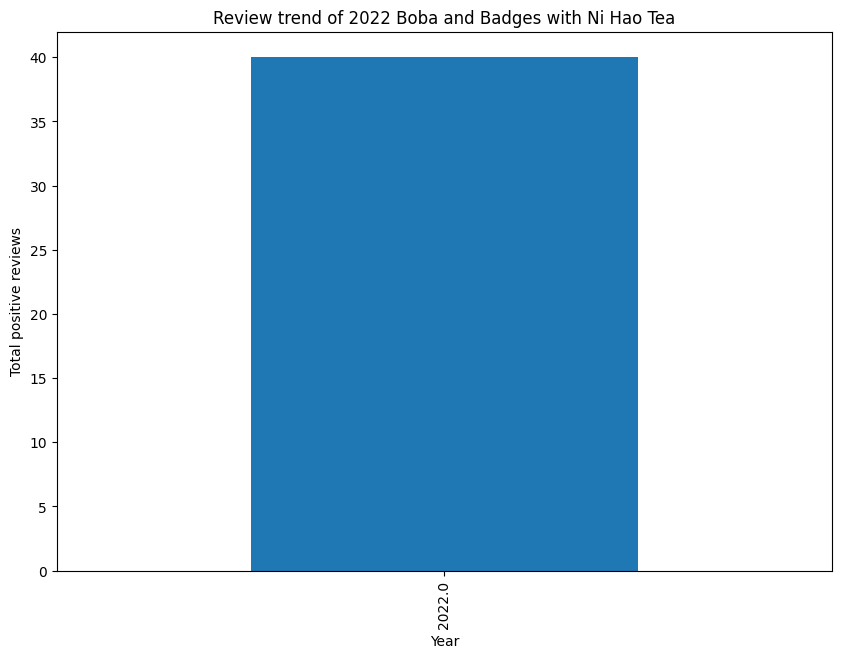

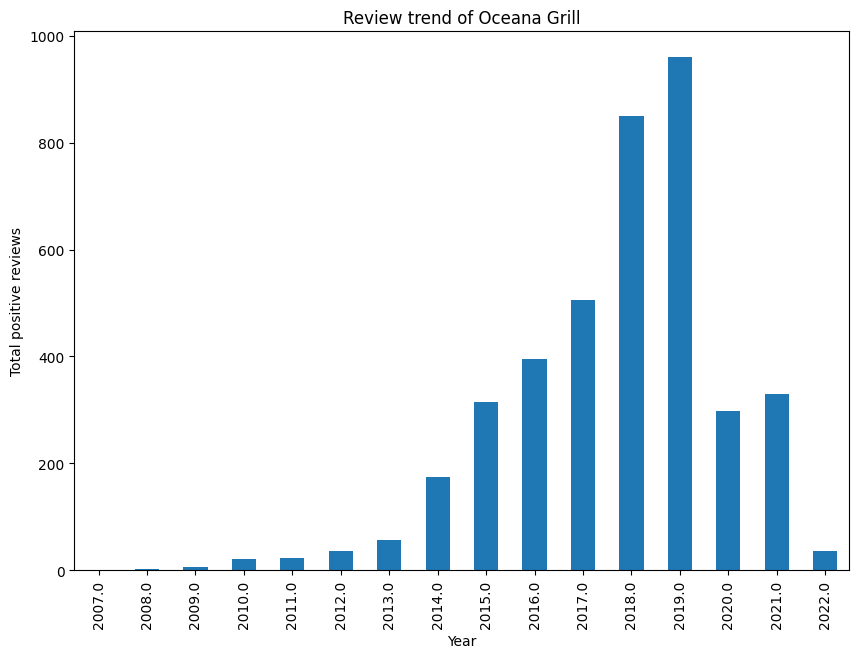

In [44]:
top_business = 3
temp = review_df[["business_id",'year',"stars"]]
five_star_reviews = temp[temp["stars"]>4]
trending_business_reviews = five_star_reviews.groupby(["business_id",'year']).size().reset_index(name='counts')

trending = trending_business_reviews.sort_values(['year','counts'])[::-1][:top_business].business_id.values
for  business_id in trending:
    record = trending_business_reviews.loc[trending_business_reviews['business_id'] == business_id]
    business_name = business_df.loc[business_df['business_id'] == business_id].name.values[0]
    series = pd.Series(record["counts"].values, index=record.year.values, name='Trending business')
    axes = series.plot(kind="bar",figsize=(10, 7))
    plt.xlabel('Year', axes=axes)
    plt.ylabel('Total positive reviews', axes=axes)
    plt.title('Review trend of {}'.format(business_name), axes=axes)
    plt.show()
    #len(trending_business_reviews)

From above graphs one can easliy see that "yelp texas elite park ellens greek yogurt" is new commer in business and has got most reviews in year 2021. And "terry black barbecue" is able to maintain it reviews which indicate persistant quality standards.  although there are some  decline its due to the covid pandameic suitation.

.

# Categories of top reviewed businesses

This section can answer the question "What categories of businesses are at succeeding?" Good reviews means customers are happy to visit and take time to write reviews.

<AxesSubplot: title={'center': ' Categories of top reviewed businesses'}, ylabel='Top business types'>

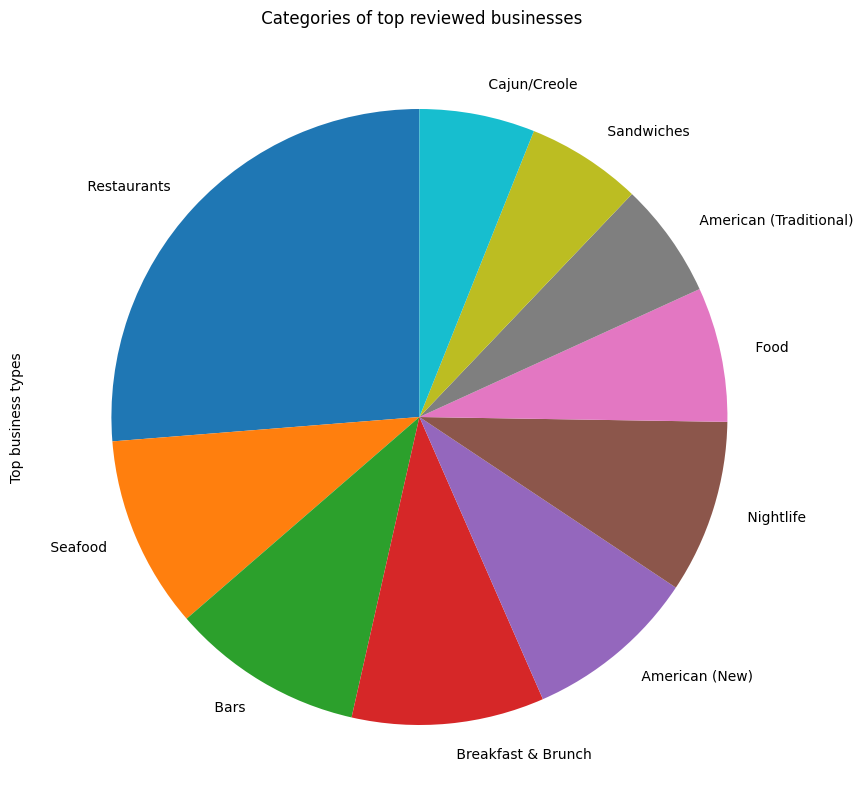

In [45]:
num_cat =10 # to show top 10 catrgories
top_business = 30 # choose categories of top 30 businesses
cat_data = top_business_data.sort_values("rated")[::-1][:top_business]
#cat_data.categories
Categories={}
for cat in cat_data.categories.values:
    all_categories= cat.split(",")
    for x in all_categories:
        try :
            Categories[x] =Categories[x]+1
        except:
            Categories[x]=1
top_categories = pd.DataFrame.from_dict(data= Categories,orient="index")
top_categories.reset_index(inplace=True)
top_categories.columns = ['category', 'occurance']

x_val=top_categories.sort_values("occurance")[::-1][:num_cat].occurance.values
labels=top_categories.sort_values("occurance")[::-1][:num_cat].category.values
series = pd.Series(x_val, index=labels, name='Top business types')
series.plot.pie(figsize=(10, 10),startangle=90,title=' Categories of top reviewed businesses')




These are categories segment which hves high ratings,A new business in these catergories can be profitable if we were able to maintain a good quality with high demand.

# Categories of trending businesses

<AxesSubplot: title={'center': ' top 10 catrgories  of trending businesses'}, ylabel='Top business types'>

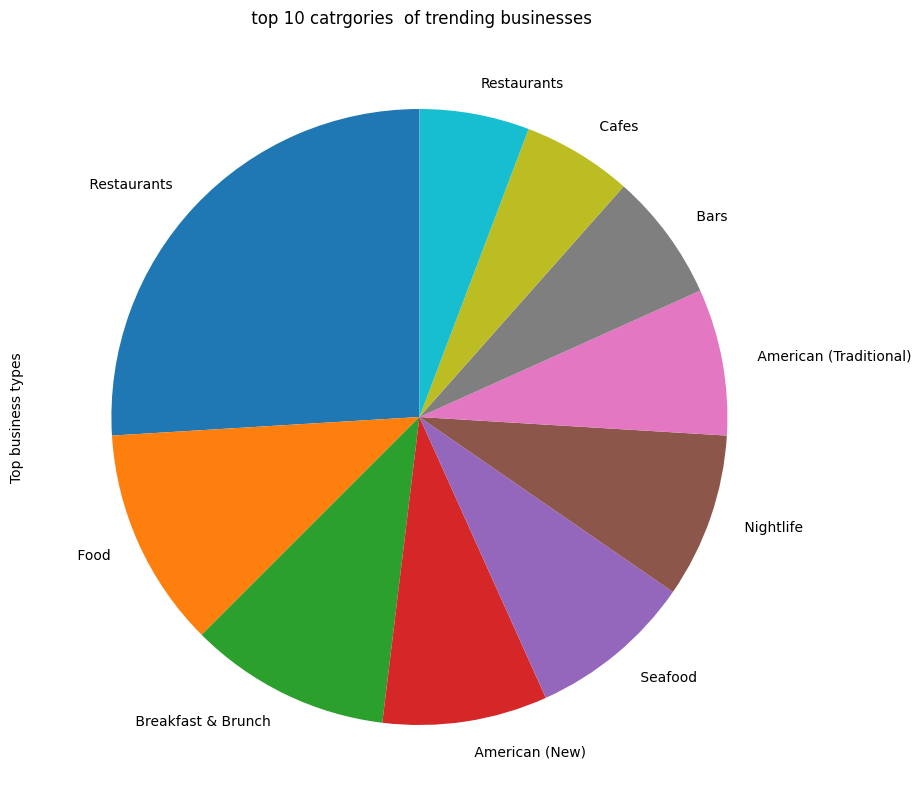

In [46]:
num_cat =10 # to show top 10 catrgories
top_business = 40 # choose categories of top 30 businesses
business_ids = trending_business_reviews.sort_values(['year','counts'])[::-1][:top_business].business_id.values
cat_data = top_business_data.loc[top_business_data['business_id'].isin(business_ids)]
#cat_data.categories
Categories={}
for cat in cat_data.categories.values:
    all_categories= cat.split(",")
    for x in all_categories:
        try :
            Categories[x] =Categories[x]+1
        except:
            Categories[x]=1
top_categories = pd.DataFrame.from_dict(data= Categories,orient="index")
top_categories.reset_index(inplace=True)
top_categories.columns = ['category', 'occurance']

x_val=top_categories.sort_values("occurance")[::-1][:num_cat].occurance.values
labels=top_categories.sort_values("occurance")[::-1][:num_cat].category.values
series = pd.Series(x_val, index=labels, name='Top business types')
series.plot.pie(figsize=(10, 10),startangle=90,title=' top 10 catrgories  of trending businesses')


By comparing above two pie chart one can say "ASIAN FUSION " is  a trending category of business but not getting higher review, if were able to tap customer demand in this section we can earn huge profit .

# Negatively reviewed businesses

In [47]:
bottom_reviewed = review_df[review_df["stars"]<2]
bottom_reviews_dict ={} 

for business_id in bottom_reviewed["business_id"].values:
    try :
        bottom_reviews_dict[business_id] =bottom_reviews_dict[business_id]+1
    except:
        bottom_reviews_dict[business_id]=1
        
bottombusiness = pd.DataFrame.from_dict(data= bottom_reviews_dict,orient="index")

bottombusiness.reset_index(inplace=True)
#bottombusiness.head()
bottombusiness.columns = ['business_id', 'rated']

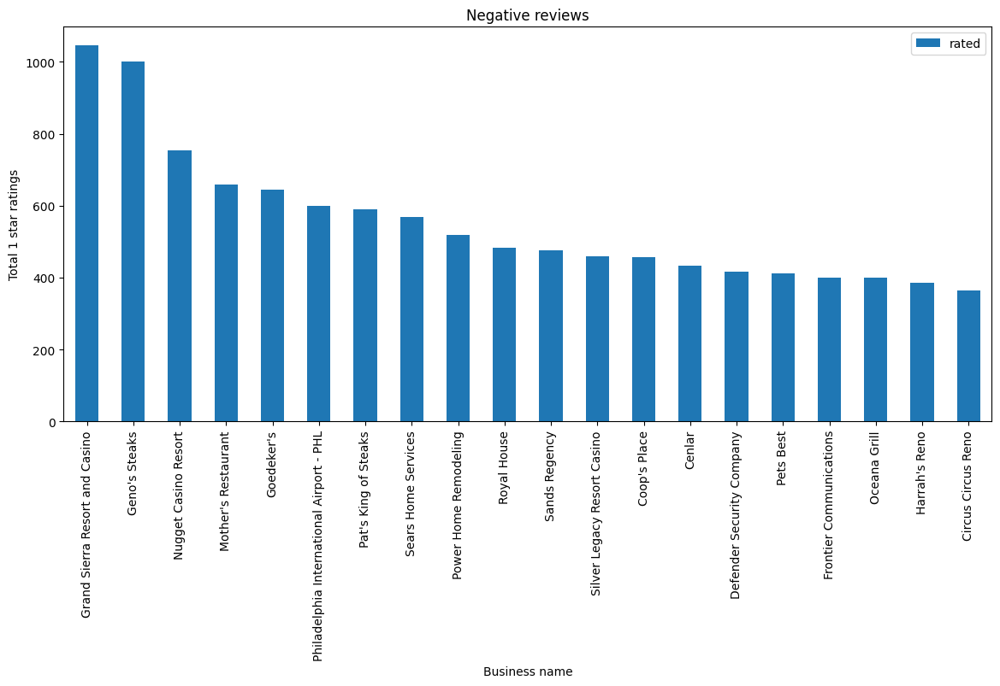

In [48]:
top_count= 20
right=pd.DataFrame(business_df[['business_id',"name","categories"]].values,
                    columns=['business_id',"Business name","categories"])

bottom_business_data = pd.merge(bottombusiness,right=right, how="inner",on='business_id')
bottom_business_data.sort_values("rated")[::-1][:top_count].plot(x="Business name",y="rated", 
                                                   kind="bar",figsize=(14,6),
                                                   title='Negative reviews').set_ylabel("Total 1 star ratings")

del(bottom_reviewed)
del(bottom_reviews_dict)
del(bottombusiness)
del(right)


Above plot shows that  "economy rent a car" is most  negatively reviewed.we dont think investing in this bussiness is good option because of a psychological bias of customer towards the item no matter how good functionality it offers.

for example, no matter how good featues an application posess from china but we indian will boycott it due to sentiments againt the china.



# Business categories which needs improvement

The categories of businesses which which are getting negative reviews definitely need to improve their services. Or this insight can be used by their competitors to start new business nearby.

<AxesSubplot: title={'center': 'top 10 catrgories which needs improvement'}, ylabel='Categories'>

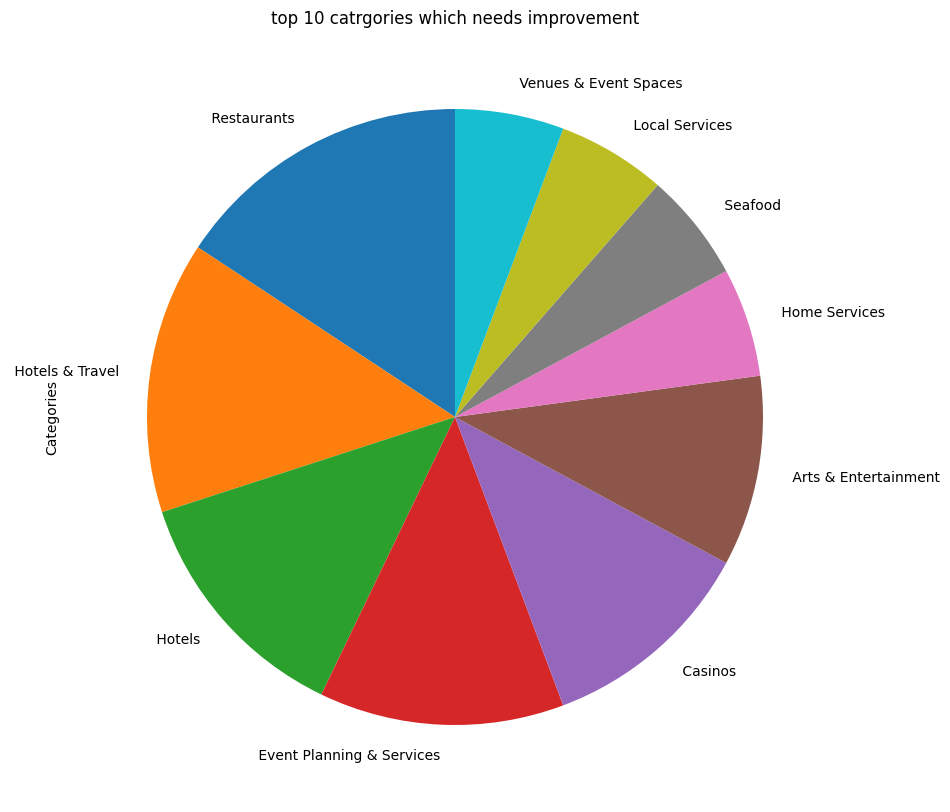

In [49]:
num_cat =10 # to show top 10 catrgories
bottom_business = 30 # choose categories of top 30 businesses
cat_data = bottom_business_data.sort_values("rated")[::-1][:bottom_business]

Categories={}
for cat in cat_data.categories.values:
    all_categories= cat.split(",")
    for x in all_categories:
        try :
            Categories[x] =Categories[x]+1
        except:
            Categories[x]=1
bottom_categories = pd.DataFrame.from_dict(data= Categories,orient="index")
bottom_categories.reset_index(inplace=True)
bottom_categories.columns = ['category', 'occurance']

x_val=bottom_categories.sort_values("occurance")[::-1][:num_cat].occurance.values
labels=bottom_categories.sort_values("occurance")[::-1][:num_cat].category.values
series = pd.Series(x_val, index=labels, name='Categories')
series.plot.pie(figsize=(10, 10),startangle=90,title='top 10 catrgories which needs improvement')



##REVIEW TABLE INSIGHT WITH PLOTS:

In [50]:
# let us import the dataset for review
yelp_review= pd.read_csv('../data/processed/review_df.csv')

Lets get the overview of reviews.

In [51]:
review_df.head()

,review_id,user_id,business_id,stars,useful,funny,cool,text,date,year
0,KU_O5udG6zpxOg-VcAEodg,mh_-eMZ6K5RLWhZyISBhwA,XQfwVwDr-v0ZS3_CbbE5Xw,3.0,0.0,0.0,0.0,"If you decide to eat here, just be aware it is...",2018-07-07 22:09:11,2018.0
1,BiTunyQ73aT9WBnpR9DZGw,OyoGAe7OKpv6SyGZT5g77Q,7ATYjTIgM3jUlt4UM3IypQ,5.0,1.0,0.0,1.0,I've taken a lot of spin classes over the year...,2012-01-03 15:28:18,2012.0
2,saUsX_uimxRlCVr67Z4Jig,8g_iMtfSiwikVnbP2etR0A,YjUWPpI6HXG530lwP-fb2A,3.0,0.0,0.0,0.0,Family diner. Had the buffet. Eclectic assortm...,2014-02-05 20:30:30,2014.0
3,AqPFMleE6RsU23_auESxiA,_7bHUi9Uuf5__HHc_Q8guQ,kxX2SOes4o-D3ZQBkiMRfA,5.0,1.0,0.0,1.0,"Wow! Yummy, different, delicious. Our favo...",2015-01-04 00:01:03,2015.0
4,Sx8TMOWLNuJBWer-0pcmoA,bcjbaE6dDog4jkNY91ncLQ,e4Vwtrqf-wpJfwesgvdgxQ,4.0,1.0,0.0,1.0,Cute interior and owner (?) gave us tour of up...,2017-01-14 20:54:15,2017.0


In [52]:
# we will add separate columns for date with features added seperately.
review_df["date"]=  pd.to_datetime(review_df["date"], format='%Y-%m-%d')
review_df['year'] = review_df.date.dt.year
review_df['day'] = review_df.date.dt.day
review_df['month'] = review_df.date.dt.month
review_df['year'] = review_df.date.dt.year
review_df['hour'] = review_df.date.dt.hour
review_df['minute'] = review_df.date.dt.minute
review_df['second'] = review_df.date.dt.second

review_df.head()


,review_id,user_id,business_id,stars,useful,funny,cool,text,date,year,day,month,hour,minute,second
0,KU_O5udG6zpxOg-VcAEodg,mh_-eMZ6K5RLWhZyISBhwA,XQfwVwDr-v0ZS3_CbbE5Xw,3.0,0.0,0.0,0.0,"If you decide to eat here, just be aware it is...",2018-07-07 22:09:11,2018.0,7.0,7.0,22.0,9.0,11.0
1,BiTunyQ73aT9WBnpR9DZGw,OyoGAe7OKpv6SyGZT5g77Q,7ATYjTIgM3jUlt4UM3IypQ,5.0,1.0,0.0,1.0,I've taken a lot of spin classes over the year...,2012-01-03 15:28:18,2012.0,3.0,1.0,15.0,28.0,18.0
2,saUsX_uimxRlCVr67Z4Jig,8g_iMtfSiwikVnbP2etR0A,YjUWPpI6HXG530lwP-fb2A,3.0,0.0,0.0,0.0,Family diner. Had the buffet. Eclectic assortm...,2014-02-05 20:30:30,2014.0,5.0,2.0,20.0,30.0,30.0
3,AqPFMleE6RsU23_auESxiA,_7bHUi9Uuf5__HHc_Q8guQ,kxX2SOes4o-D3ZQBkiMRfA,5.0,1.0,0.0,1.0,"Wow! Yummy, different, delicious. Our favo...",2015-01-04 00:01:03,2015.0,4.0,1.0,0.0,1.0,3.0
4,Sx8TMOWLNuJBWer-0pcmoA,bcjbaE6dDog4jkNY91ncLQ,e4Vwtrqf-wpJfwesgvdgxQ,4.0,1.0,0.0,1.0,Cute interior and owner (?) gave us tour of up...,2017-01-14 20:54:15,2017.0,14.0,1.0,20.0,54.0,15.0


##SENTIMENT ANALYSIS WITH POLARITY SCORE

In this graph, we plotted the polarity of sentiments from reviews ranging from -1 (Negative)  to +1 (positive), we can see that more of the people have given positive reviews than negative review. We also hued them with ratings and found that most of the reviews are aligned with the reviews but there are some outliers (where reviews are not aligned to the rating)

## TOTAL STAR DISTRIBUTION FOR REVIEW COUNT

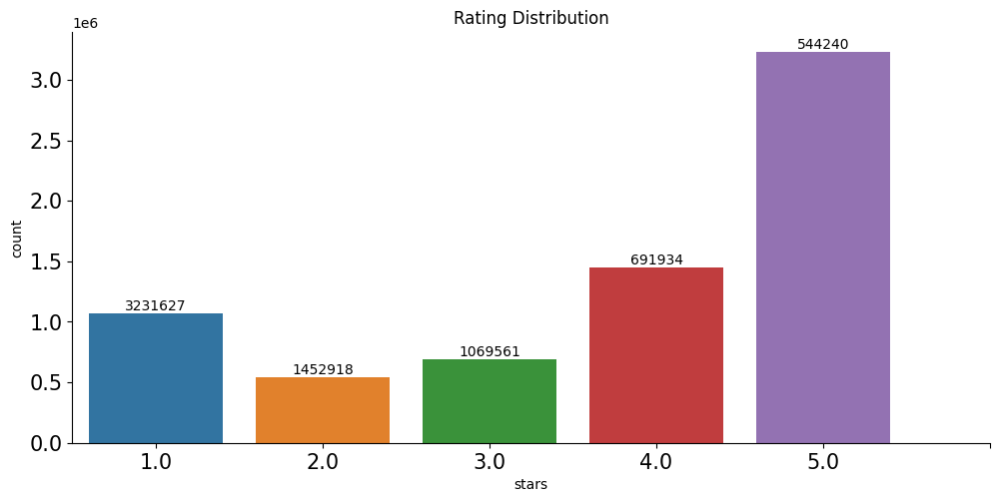

In [53]:
sns.catplot(data=review_df, x='stars', kind='count', aspect=2)
ax = plt.gca()
ax.set(xticks=[0,1,2,3,4,5], title='Rating Distribution')
ax.tick_params('x', labelsize=15)
ax.tick_params('y', labelsize=15)
rects = ax.patches
labels = review_df["stars"].value_counts()
for rect, label in zip(rects, labels):
    height = rect.get_height()
    ax.text(rect.get_x() + rect.get_width()/2, height + 5, label, ha='center', va='bottom')

plt.show()

 This graph shows that distribution  count for 1-5 star ratings.We infer that distribution of rating for stars 5 is high. Its seen that mostly people tend to give higher stars to a product.

Number of reviews by Year

This graph shows number of reviews increased exponentially over the years. This could also be an evidence for yelp's popularity over the years.and also we see in year 2020 and 2021 it has decreased rapidily due to covid pandemic suitation.

## TREND OF RATINGS WITH  MONTH 

Text(0.5, 1.0, 'Ratings by Month')

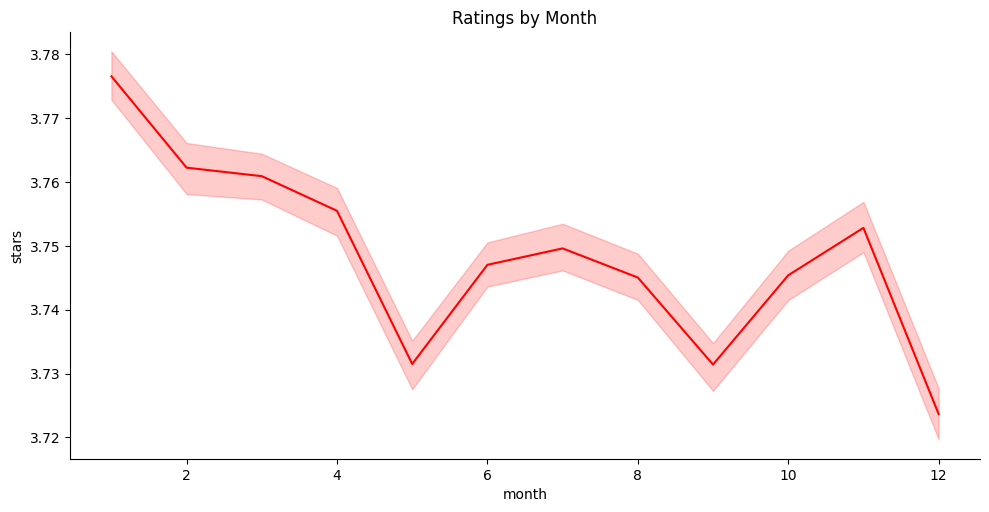

In [54]:
g = sns.relplot(data=review_df, x='month', y='stars', aspect=2, kind='line',color='r')
ax = plt.gca()
ax.set_title('Ratings by Month')

We infer from the graph that  people in america tend to review the average rating lies around (3.71 -3.75) . But if we look at the y-scale, change is not so significant to draw a trend.

## TREND OF RATINGS WITH DAY

Text(0.5, 1.0, 'Ratings by Day')

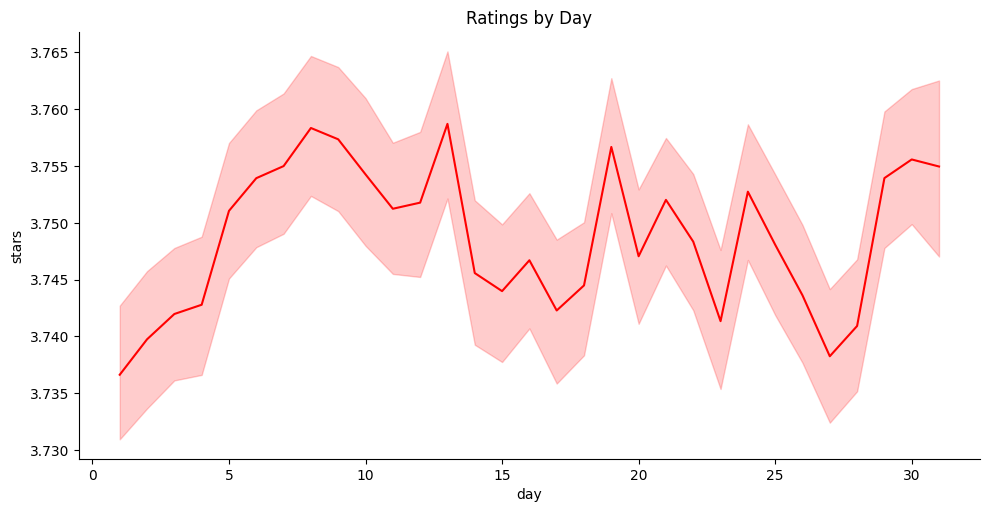

In [55]:
g = sns.relplot(data=review_df, x='day', y='stars', aspect=2, kind='line',color='red')
ax = plt.gca()
ax.set_title('Ratings by Day')

We infer that  inbetween 5th to 10th day is max ratings stars . But if we look at the y-scale, change is not so significant to draw a trend.

TREND OF TOTAL REVIEW COUNT WITH HOURS(24)

This graphs gives the insight that  minimum number of reviews were given during the 7 am to 11 am morning and count keeps rising throughout the day which seems attractive. But maximum number of reviews were given at 7pm . It is possible tend to review in thier free time after their daily work is done.During 7 am to 11 am its decline  due to peak hours and people are getting ready for thier work.

In [56]:
useful_reviews = len(review_df[review_df["useful"]>0])
cool_reviews = len(review_df[review_df["cool"]>0])
funny_reviews = len(review_df[review_df["funny"]>0])
negative_reviews = len(review_df[review_df["stars"]<2])
positive_reviews =len(review_df[review_df["stars"]>3])
total_reviews = len(review_df)

print("Total reviews: {}".format(total_reviews))
print("Useful reviews: {}".format(useful_reviews))
print("Funny reviews: {}".format(funny_reviews))
print("Cool reviews: {}".format(cool_reviews))
print("Total negative reviews: {}".format(negative_reviews))
print("Total positive reviews: {}".format(positive_reviews))

Total reviews: 6990282
Useful reviews: 3149784
Funny reviews: 1096161
Cool reviews: 1612315
Total negative reviews: 1069561
Total positive reviews: 4684545


This review  has more number of positive reviews compared to the negative reviews.

##USER TABLE INSIGHT:

In [57]:
#load the dataset

yelp_users = pd.read_csv('/Users/adrianadevicente/Documents/CUNEF/MACHIN/yelp_dataset/user_df.csv')

In [58]:
yelp_users.head()

,user_id,name,review_count,yelping_since,useful,funny,cool,elite,friends,fans,...,compliment_more,compliment_profile,compliment_cute,compliment_list,compliment_note,compliment_plain,compliment_cool,compliment_funny,compliment_writer,compliment_photos
0,qVc8ODYU5SZjKXVBgXdI7w,Walker,585,2007-01-25 16:47:26,7217,1259,5994,2007,"NSCy54eWehBJyZdG2iE84w, pe42u7DcCH2QmI81NX-8qA...",267,...,65,55,56,18,232,844,467,467,239,180
1,j14WgRoU_-2ZE1aw1dXrJg,Daniel,4333,2009-01-25 04:35:42,43091,13066,27281,"2009,2010,2011,2012,2013,2014,2015,2016,2017,2...","ueRPE0CX75ePGMqOFVj6IQ, 52oH4DrRvzzl8wh5UXyU0A...",3138,...,264,184,157,251,1847,7054,3131,3131,1521,1946
2,2WnXYQFK0hXEoTxPtV2zvg,Steph,665,2008-07-25 10:41:00,2086,1010,1003,"2009,2010,2011,2012,2013","LuO3Bn4f3rlhyHIaNfTlnA, j9B4XdHUhDfTKVecyWQgyA...",52,...,13,10,17,3,66,96,119,119,35,18
3,SZDeASXq7o05mMNLshsdIA,Gwen,224,2005-11-29 04:38:33,512,330,299,"2009,2010,2011","enx1vVPnfdNUdPho6PH_wg, 4wOcvMLtU6a9Lslggq74Vg...",28,...,4,1,6,2,12,16,26,26,10,9
4,hA5lMy-EnncsH4JoR-hFGQ,Karen,79,2007-01-05 19:40:59,29,15,7,NaN,"PBK4q9KEEBHhFvSXCUirIw, 3FWPpM7KU1gXeOM_ZbYMbA...",1,...,1,0,0,0,1,1,0,0,0,0


Text(0.5, 1.0, 'Review count')

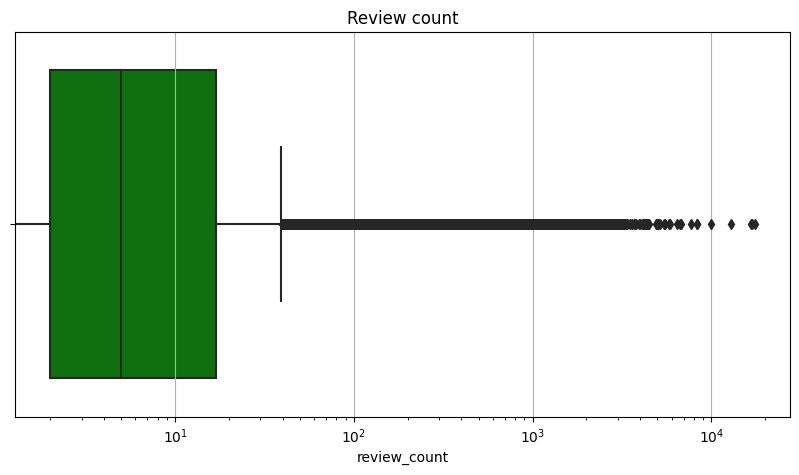

In [59]:
plt.figure(figsize=(10,5))
ax = plt.gca()
sns.boxplot(data=yelp_users, x='review_count', ax=ax,color='green')
ax.xaxis.grid(True)
plt.xscale('log')
plt.title("Review count")


The boxplot for review count reveals a lot of outliers. There are some users who have written over 10k reviews.

/var/folders/06/qj712s454zn0tljflkrgpwwm0000gn/T/ipykernel_2387/4105970702.py:1: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



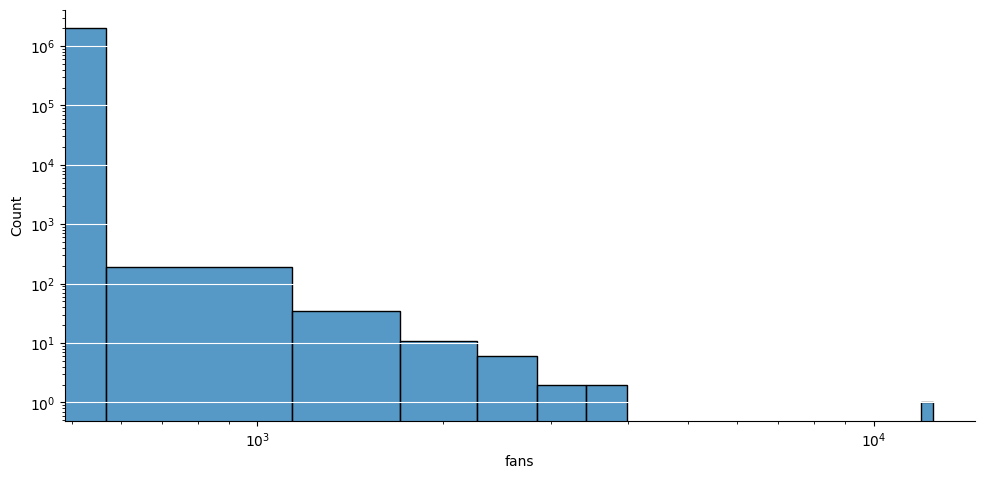

In [60]:
sns.displot(data=yelp_users, x='fans', aspect=2,palette=sns.color_palette("Set2"))
plt.gca()
plt.xscale('log')
plt.yscale('log')
plt.grid(False)
plt.grid(axis = 'y', color ='white', linestyle='-')

Some users are wildly popular reviewers on yelp. Most people have few or no fans.There are only few people who are having maximum fan following.

# Lets find relationship between users's friends and review patterns

In [61]:
top_users = 15
user_most_reviews = yelp_review.groupby(['user_id']).size().reset_index(name='counts')
top_users_ids = user_most_reviews.sort_values(['counts'])[::-1][:top_users].user_id.values

In [62]:
user_frnds = {}
for  users_id in top_users_ids:
    
    record = yelp_users.loc[yelp_users['user_id'] == users_id]
    user_frnds[users_id] = {}
    user_frnds[users_id]["name"]= record.name.values[0]
    user_frnds[users_id]["friends"]= record.friends.values[0]
    if record.friends is not "None":
        user_frnds[users_id]["friends_count"]= len(record.friends.values[0].split(","))
    else:
        user_frnds[users_id]["friends_count"]=0
    user_frnds[users_id]["review_count"]=record.review_count.values[0]
    user_frnds[users_id]["fans"]=record.fans.values[0]

<>:8: SyntaxWarning:

"is not" with a literal. Did you mean "!="?

<>:8: SyntaxWarning:

"is not" with a literal. Did you mean "!="?

/var/folders/06/qj712s454zn0tljflkrgpwwm0000gn/T/ipykernel_2387/3503401657.py:8: SyntaxWarning:

"is not" with a literal. Did you mean "!="?



In [63]:
 user_friend_df = pd.DataFrame.from_dict(data= user_frnds,orient="index")

In [64]:
user_friend_df.head()

,name,friends,friends_count,review_count,fans
_BcWyKQL16ndpBdggh2kNA,Karen,"7m_akadoxv4hK1SjTeIcqA, inNUfHhxIAwe6vp-2ptYWA...",3708,4274,558
Xw7ZjaGfr0WNVt6s_5KZfA,Marielle,"y6QtovGmO4WIBwkJFVr7dA, dxXC4MRVeJiwEgV6Aqm9kw...",1257,2272,379
0Igx-a1wAstiBDerGxXk2A,Jen,"6Wipmp3NrR427ZtHXF7Xyw, GJv1yf_IhUZqpDjFr86DmA...",589,2733,200
-G7Zkl1wIWBBmD0KRy_sCw,Gerald,"BJyShgQGMJTRn-sQbIQ10Q, AYQGK2AZkIPkrqgAb72Qkg...",1787,3131,703
ET8n-r7glWYqZhuR6GcdNw,Michelle,"jPRDnnoCvJi2plYWWAoOcw, k8y8sNAXTl6XMzg5Qr61rg...",5958,2256,1353


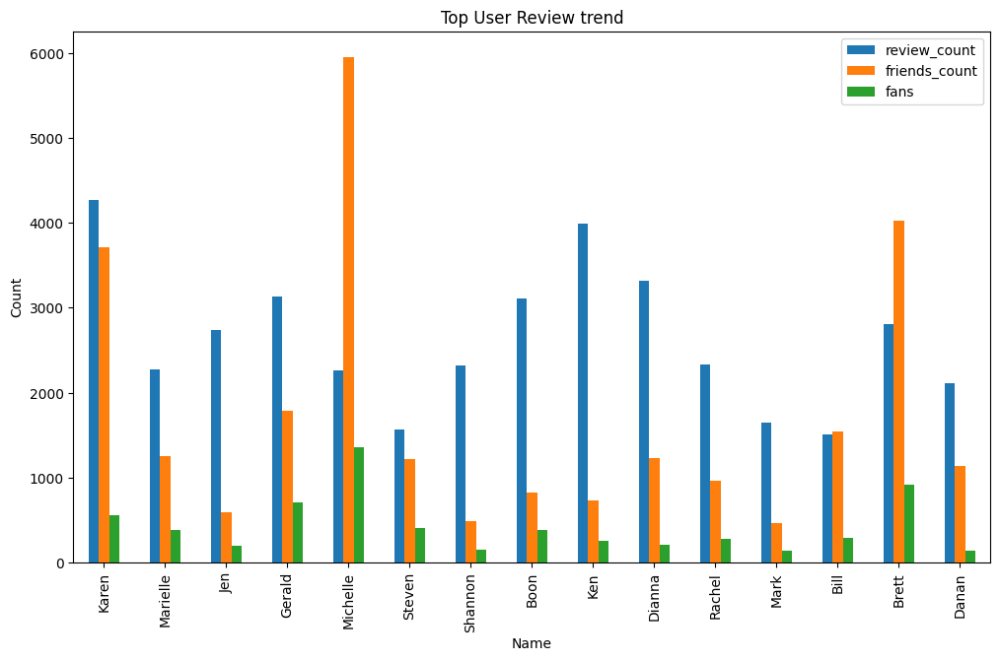

In [65]:
axes = user_friend_df.plot(x="name", y=["review_count", "friends_count", "fans"],
                           kind="bar",figsize=(12, 7))
plt.xlabel('Name', axes=axes)
plt.ylabel('Count', axes=axes)
plt.title('Top User Review trend'.format(business_name), axes=axes)
plt.show()

From above graph we can see there is no defined relashionship between user's fans, friends and review count. User reviewing for a business totally depends on user's character and/or satisfaction with business services.

# Does user's friends infulence business review?

Lets find trending business and its top users. Then we will cross check with yelp user database if a particular user's friend also has given rating to that business or not.

In [66]:
business_rank = 4 # 0 to 9
temp = yelp_review[["business_id",'date',"stars"]]
five_star_reviews = temp[temp["stars"]>4]
trending_business_reviews = five_star_reviews.groupby(["business_id",'date']).size().reset_index(name='counts')

business_id = trending_business_reviews.sort_values(['date','counts'])[::-1][:10].business_id.values[business_rank]
business_name = business_df.loc[business_df['business_id'] == business_id].name.values[0]

In [67]:
user_reviews = yelp_review.loc[yelp_review['business_id']==business_id]
topuser_reviws = user_reviews.groupby(['user_id']).size().reset_index(name='counts')
print("Total users who gave ratings to {} are {}".format(business_name,len(topuser_reviws)))

Total users who gave ratings to Nola Desi Kitchen are 120


In [68]:
top_users = 50 #len(topuser_reviws)// 10
topuser_reviws = topuser_reviws.sort_values(['counts'])[::-1][:top_users]

In [69]:
%%time

users_ids = topuser_reviws.user_id.values
users_ids = pd.merge(topuser_reviws,right=yelp_users, how="inner",on='user_id')
users_ids =users_ids [["name","user_id", "friends"]]


CPU times: user 1.13 s, sys: 1.2 s, total: 2.32 s
Wall time: 2.51 s


In [70]:
%%time
def calc_frnd_review(frnds, business_id, yelp_review):
        frnds = frnds.split(',')
        # count reviews
        #frnds = yelp_users.loc[(yelp_users['user_id'].isin(frnds)) & (yelp_users["review_count"]>0 )].user_id.values
        friend_review = yelp_review.loc[(yelp_review['business_id']==business_id) &
                                        (yelp_review['user_id'].isin(frnds))
                                       ][["stars","user_id"]]
        friend_review_cnt = len(friend_review.user_id.values)
        if(friend_review_cnt>0):
            total_stars = friend_review.stars.sum()
        else:
            total_stars = 0
        return  friend_review_cnt,total_stars

users_ids[["frnd_count","total_stars"]]= users_ids["friends"].apply(lambda frnds: pd.Series(calc_frnd_review(frnds, business_id, yelp_review), index=['frnd_count','total_stars']))

CPU times: user 25.6 s, sys: 338 ms, total: 25.9 s
Wall time: 26.1 s


In [71]:
users_ids[users_ids["frnd_count"]>0]

,name,user_id,friends,frnd_count,total_stars
7,Dawnene,N7-qpBvof7EQq4bPejEagA,"EP8o8JnQSI0WEkeodwA8lA, 9N6a-h8UJfWxUId0skpOog...",1.0,4.0


So we can see here, not much users could have been somehow influenced by their friends's top ratings to a business, because there is only one user whose friend also rated 5 star for "Laura" when "Jazzy" gave 5 rating to it (Here we have taken only 50  into account because this task is very resource heavy).

## TIPS DATASET

In [72]:
yelp_tips = pd.read_csv('../data/processed/yelp_academic_dataset_tip.csv')
yelp_tips.head()

,user_id,business_id,text,date,compliment_count
0,AGNUgVwnZUey3gcPCJ76iw,3uLgwr0qeCNMjKenHJwPGQ,Avengers time with the ladies.,2012-05-18 02:17:21,0
1,NBN4MgHP9D3cw--SnauTkA,QoezRbYQncpRqyrLH6Iqjg,They have lots of good deserts and tasty cuban...,2013-02-05 18:35:10,0
2,-copOvldyKh1qr-vzkDEvw,MYoRNLb5chwjQe3c_k37Gg,It's open even when you think it isn't,2013-08-18 00:56:08,0
3,FjMQVZjSqY8syIO-53KFKw,hV-bABTK-glh5wj31ps_Jw,Very decent fried chicken,2017-06-27 23:05:38,0
4,ld0AperBXk1h6UbqmM80zw,_uN0OudeJ3Zl_tf6nxg5ww,Appetizers.. platter special for lunch,2012-10-06 19:43:09,0


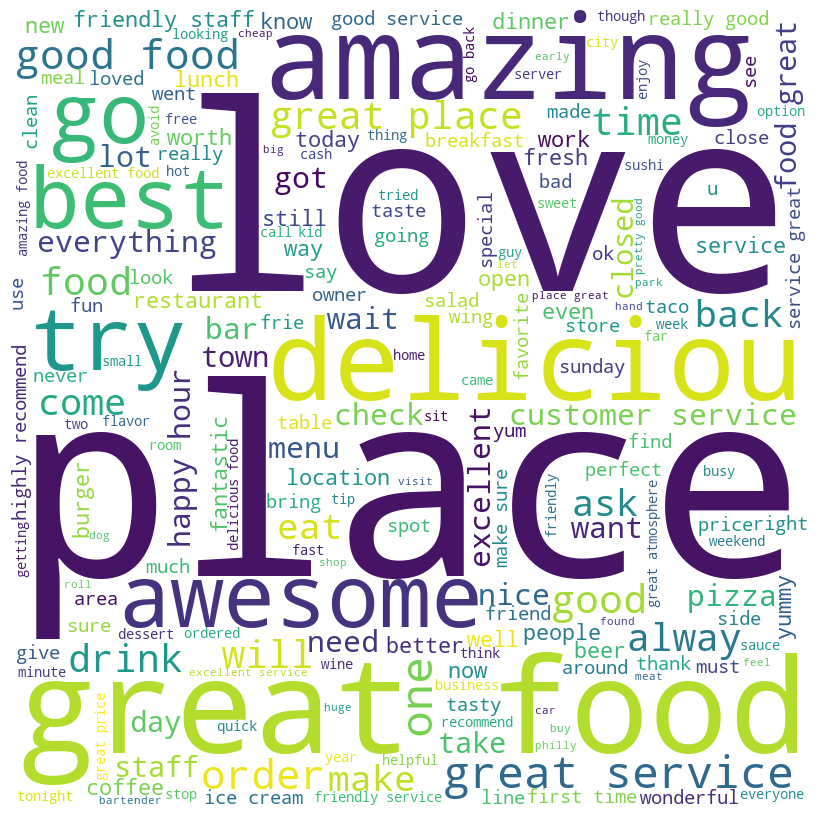

In [73]:

# importing all necessary modules
from wordcloud import WordCloud, STOPWORDS

 
comment_words = ''
stopwords = set(STOPWORDS)
 
# iterate through the csv file
for val in yelp_tips.text:
     
    # typecaste each val to string
    val = str(val)
 
    # split the value
    tokens = val.split()
     
    # Converts each token into lowercase
    for i in range(len(tokens)):
        tokens[i] = tokens[i].lower()
     
    comment_words += " ".join(tokens)+" "
 
wordcloud = WordCloud(width = 800, height = 800,
                background_color ='white',
                stopwords = stopwords,
                min_font_size = 10).generate(comment_words)
 
# plot the WordCloud image                      
plt.figure(figsize = (8, 8), facecolor = None)
plt.imshow(wordcloud)
plt.axis("off")
plt.tight_layout(pad = 0)
 
plt.show()

This plot gives the most repeated words in tips. and we see that most of the words repeated have good reveiws about the resturants which asserts our assumption mostly people tend to write good review which gives happy customer